In [696]:
%matplotlib inline
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from statistics import mean
from pyquaternion import Quaternion
import matplotlib
from matplotlib import pyplot as plt
from matplotlib import animation, rc
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML
import math
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Read in Data and Preprocessing Data

In [697]:
# ac2 = pd.read_csv('accel_file_1621445529.7862139.txt')
# gy2 = pd.read_csv('gyro_file_1621445529.81636.txt')

# ac2 = pd.read_csv('accel_file_1621471934.548843.txt')
# gy2 = pd.read_csv('gyro_file_1621471934.573803.txt')

ac2 = pd.read_csv('accel_file_1621546377.6777558.txt')
gy2 = pd.read_csv('gyro_file_1621546377.7080789.txt')

new_ac2 = ac2
if len(ac2) > len(gy2):
    new_ac2 = ac2.iloc[0:len(ac2) - 1, 0:]

cut = len(new_ac2) % 1000 - 1
new_ac2 =new_ac2.iloc[cut:len(new_ac2)-0, 0:]
new_gy2 =gy2.iloc[cut:len(gy2)-0, 0:]

new_gy3 = new_gy2[["x","y","z"]]
new_ac3 = new_ac2[["x","y","z"]]
est_Ws = []       # gyro readings
est_local_As = [] # accelerometer readings
thresh_hold =100000 #0.06

for (g_row, g_values), (a_row , a_values) in zip(new_gy3.iterrows(), new_ac3.iterrows()):
        g_s = [g_values[0] , g_values[1], g_values[2]]
        a_s = [a_values[0] , a_values[1], a_values[2]]
        if g_row == cut:
            est_Ws.append(g_s)
            est_local_As.append(a_s)
        elif abs(g_s[0] - est_Ws[len(est_Ws) - 1][0]) >  thresh_hold or abs(g_s[1] - est_Ws[len(est_Ws) - 1][1]) >  thresh_hold  or abs(g_s[2] - est_Ws[len(est_Ws) - 1][2]) >  thresh_hold   or abs(a_s[0] - est_local_As[len(est_local_As) - 1][0])  >  thresh_hold  or abs(a_values[1] - est_local_As[len(est_local_As) - 1][1]) >  thresh_hold  or abs(a_values[2] - est_local_As[len(est_local_As) - 1][2]) >  thresh_hold:
            print("no add: ", g_row)

        else:
            est_Ws.append(g_s)
            est_local_As.append(a_s)

# Accelerometer: Raw Data 5 + Minutes Still

In [698]:
fig_ac2_x = go.Figure(go.Scatter(x = new_ac2['ts'], y = new_ac2['x'], name='x_accel'))
fig_ac2_x.update_layout(title='x_accel vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)
fig_ac2_y = go.Figure(go.Scatter(x = new_ac2['ts'], y = new_ac2['y'], name='y_accel'))
fig_ac2_y.update_layout(title='y_accel vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)
fig_ac2_z = go.Figure(go.Scatter(x = new_ac2['ts'], y = new_ac2['z'], name='z_accel'))
fig_ac2_z.update_layout(title='z_accel vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)


fig_ac2_x.show()
fig_ac2_y.show()
fig_ac2_z.show()

## Accelerometer: Axis Bias

In [699]:
ac2_x_avg = mean(new_ac2['x'])
ac2_y_avg = mean(new_ac2['y'])
ac2_z_avg = mean(new_ac2['z'])
print("x accel bias:",ac2_x_avg,", y accel bias:",ac2_y_avg,", z accel bias:",ac2_z_avg)

x accel bias: 0.005467154705172836 , y accel bias: -1.0027479983194532 , z accel bias: 0.010190491119318655


# Gyro:  Raw Data 5 + Minutes Still

In [700]:
fig_gy2_x = go.Figure(go.Scatter(x = new_gy2['ts'], y = new_gy2['x'], name='x_gyro'))
fig_gy2_x.update_layout(title='x_gyro vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)
fig_gy2_y = go.Figure(go.Scatter(x = new_gy2['ts'], y = new_gy2['y'], name='y_gyro'))
fig_gy2_y.update_layout(title='y_gyro vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)
fig_gy2_z = go.Figure(go.Scatter(x = new_gy2['ts'], y = new_gy2['z'], name='z_gyro'))
fig_gy2_z.update_layout(title='z_gyro vs time', plot_bgcolor='rgb(230, 230,230)', showlegend=True)


fig_gy2_x.show()
fig_gy2_y.show()
fig_gy2_z.show()

## Gyro:  Axis Bias

In [701]:
gy2_x_avg = mean(new_gy2['x'])
gy2_y_avg = mean(new_gy2['y'])
gy2_z_avg = mean(new_gy2['z'])
print("x gyro bias:", gy2_x_avg,", y gyro bias:", gy2_y_avg,", z gyro bias:",gy2_z_avg)

x gyro bias: 0.005307499035239443 , y gyro bias: -0.0076071045342757816 , z gyro bias: 0.008861463428024074


# Gyro

In [702]:
def w_to_q_O (w, q_O, group_size, offSets = [-gy2_x_avg, -gy2_y_avg, -gy2_z_avg], sample_rate = 100):
    """sample_rates = 100           # sensor sample Frequency (Hz)"""
    delta_t = (1.0 / sample_rates)  # time intervals
    better_w = []
    better_w.append(w[0] + offSets[0])
    better_w.append(w[1] + offSets[1])
    better_w.append(w[2] + offSets[2])
    l = np.linalg.norm(better_w)                                                  # current rate of rotaion (rad/sec)
    theta = l * delta_t #* group_size  # current angle
#     if (abs(theta) < 0.00005):        
#         theta = 0 
    v = np.array([(1 / l) * better_w[0], (1 / l) * better_w[1], (1 / l) * better_w[2]]) # current axis of rotation
    q_w = Quaternion(axis = v, angle = theta)# current angular velocity quarternion
    next_q_O = (q_O * q_w)#.normalised
    return next_q_O, q_w, theta
    

In [725]:
group_size = 20
q_Ws = []                     # axis-angle representation for estimated angular velocity
q_Os = [Quaternion()]         # axis-angle representation for estimated orientaion
                              # ^q[0] identity quarterninan
                              # unit Quarterninan (this is a null quaternion 
                              # (has no effect on the rotated vector). 
                              # For the purposes of quaternion multiplication, 
                              # this is a unit quaternion (has no effect when multiplying))
# thetas = []                   # angles over time

for est_w, q in zip(est_Ws, q_Os):
    q_O, q_w, _ = w_to_q_O (est_w, q, group_size)
#     thetas.append(theta)
    q_Ws.append(q_w) 
    q_Os.append(q_O)

### Graph: Gyro 5+ min corrected

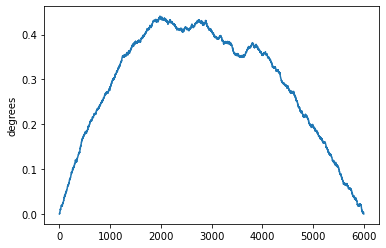

In [726]:
# graph tilt error
up = [0, 1, 0]
gyro_tilt_errors = []
for q_O in q_Os:
    next_pos = q_O.rotate(up)
    gyro_tilt_errors.append(math.degrees(np.arccos(np.dot(next_pos, up)/(np.linalg.norm(next_pos) * np.linalg.norm(up)))))

plt.plot(gyro_tilt_errors)
plt.ylabel('degrees')
plt.show()

#  Accelerometer

In [727]:
def a_to_global_a (a, offSets=[-ac2_x_avg, -(ac2_y_avg + 1), -ac2_z_avg], q=Quaternion(), up= [0.0, 1.0, 0.0], g = [0.0, -1.0, 0.0]):
    better_a = []
    better_a.append(a[0] + offSets[0])
    better_a.append(a[1] + offSets[1])
    better_a.append(a[2] + offSets[2])
    q_a = Quaternion(axis= np.array(better_a) , radians = np.pi) # For quaternion-vector multiplication, 
                                                                    # we assume the vector is converted to a 
                                                                    # quaternion as (0, wx , wy , wz )
    # set current estimated global acceloration
    if(better_a != g):
        q_G_A = (q.inverse * q_a * q).normalised # ^a = q^(-1) ∗ ˜a ∗ q 
                                                # I think these q's should be the orientaion quarternians derived from the angilar velocity 
                                                # not sure what else they could be
                                                # q - an arbitraty orientaion
    else:
        q_G_A = q_l_A 
       
    a_G = q_G_A.rotate(up) # ^a
        
    return a_G


In [728]:
def group_avg(group):
    group_avg = []
    for a in group:
        group_avg.append(minu_g(a))
    group_avg = abs(np.mean(np.array(group_avg), axis = 0))
    return group_avg

In [729]:
def minu_g (a, g = [0.0, -1.0, 0.0]):
    return np.subtract(a, g)

In [730]:
t = [] # tilt Axies
phi_s =[] # tilt error
est_global_As = []   # estimated global acceleration 
aHats = []
avg_global_As = [] # we cannot trust accelerometer 
                    # data in the short term. 
                     # However, averaged over a long period of time, 
                     # accelerometer output (in the global frame) 
                     # produces a good estimate for the direction of gravity

for est_local_A, b_q in zip(est_local_As, q_Os):    
    a_G = a_to_global_a (est_local_A, q = b_q) # try pluggin in the q complementary filter & try doing a constant avg
    est_global_As.append(a_G)
    
G_A_groups = zip(*(iter(est_global_As),) * group_size)  
for group in G_A_groups:
    aHat = group_avg(group)
    t = [aHat[2], 0, -aHat[0]]
    phi = math.degrees(np.arccos(np.dot(aHat, up)/(np.linalg.norm(aHat) * np.linalg.norm(up))))
    phi_s.append(phi)
    for i in range(group_size):
        avg_global_As.append(aHat)
        

## Graph: Accelerometer 5+ min corrected

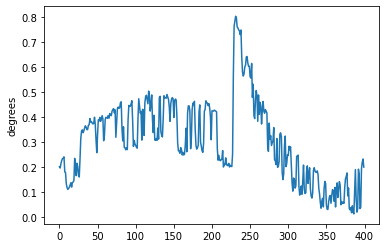

In [731]:
plt.plot(phi_s)
plt.ylabel('degrees')
plt.show()

# Both Gyro and Accelerometer

In [732]:
def betterQ (t, phi, q_O, alpha):
    return Quaternion(axis= np.array(t), radians = -alpha * phi).normalised * q_O.normalised
    

In [737]:
est_global_As = []   # estimated global acceleration 
aHats = []
alpha = 0.02
better_q_Os = [Quaternion()]
tiltCorrectedAngle = []
avg_global_As = []
phi_s =[] # tilt error
for est_local_A in est_local_As:    
    a_G = a_to_global_a (est_local_A) # try pluggin in the q complementary filter & try doing a constant avg
    est_global_As.append(a_G)
    
G_A_groups = zip(*(iter(est_global_As),) * group_size)  
# print()
for group in G_A_groups:
    aHat = group_avg(group)
    avg_global_As.append(aHat)

est_Ws_concac = []
for i in range(int((len(est_Ws)-1)/group_size)):
    est_Ws_concac.append(est_Ws[group_size*(i+1)-1])

# print(len(est_Ws_concac))
# print(len(avg_global_As))

for w, q, aHat in zip(est_Ws_concac, better_q_Os, avg_global_As):
    
    t = [aHat[2], 0, -aHat[0]]
    phi = np.arccos(np.dot(aHat, up)/(np.linalg.norm(aHat) * np.linalg.norm(up)))
    q_O, q_w, _ = w_to_q_O (est_w, q, group_size)
    better_q_O = betterQ(t, phi, q_O, alpha)
    better_q_Os.append(q_O)
    news = better_q_O.rotate(up)
    tiltCorrectedAngle.append(math.degrees(np.arccos(np.dot(news, up)/(np.linalg.norm(news) * np.linalg.norm(up)))))
    
    

## Graph: Complemetary Filter 5+ min corrected

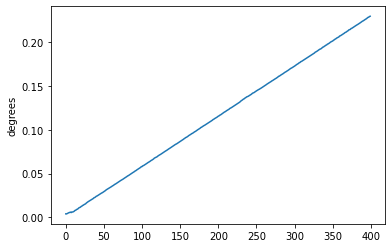

In [738]:
plt.plot(tiltCorrectedAngle)
plt.ylabel('degrees')
plt.show()

# Complemetary Filter Sim: No movement

## light blue represent the phone very slight giter is visible

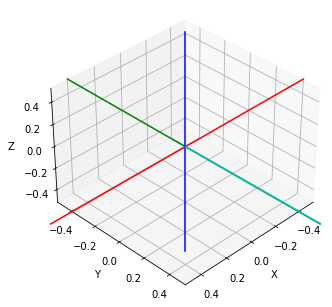

In [648]:
# Set up figure & 3D axis for animation
fig = plt.figure()
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
#ax.axis('off')

# use a different color for each axis
colors = ['r', 'g', 'b', 'c', 'm', 'y']

# set up lines and points
lines = sum([ax.plot([], [], [], c=c)
             for c in colors], [])

startpoints = np.array([[-1, 0, 0], [0, -1, 0], [0, 0, -1], [0, 0, 0], [0, 0, 0], [0, 0, 0]])
endpoints = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1], [0, 1, 0], [1, 0, 1], [1, 0, 1]])

# prepare the axes limits
ax.set_xlim((-0.5, 0.5))
ax.set_ylim((-0.5, 0.5))
ax.set_zlim((-0.5, 0.5))

# set point-of-view: specified by (altitude degrees, azimuth degrees)
ax.view_init(35, 45)


# initialization function: plot the background of each frame
def init():
    for line in lines:
        line.set_data(np.array([]), np.array([]))
        line.set_3d_properties(np.array([]))
        
    lines[0].set_data(np.array([startpoints[0][0], endpoints[0][0]]), np.array([startpoints[0][1], endpoints[0][1]]))
    lines[0].set_3d_properties(np.array([startpoints[0][2], endpoints[0][2]]))
    
    lines[1].set_data(np.array([startpoints[1][0], endpoints[1][0]]), np.array([startpoints[1][1], endpoints[1][1]]))
    lines[1].set_3d_properties(np.array([startpoints[1][2], endpoints[1][2]]))
    
    lines[2].set_data(np.array([startpoints[2][0], endpoints[2][0]]), np.array([startpoints[2][1], endpoints[2][1]]))
    lines[2].set_3d_properties(np.array([startpoints[2][2], endpoints[2][2]]))
    
    return lines

# animation function.  This will be called sequentially with the frame number
def animate(i):


    q = better_q_Os[i]

    start = q.rotate(startpoints[3])
    end = q.rotate(endpoints[3])

    
    lines[3].set_data(np.array([start[0], end[0]]), np.array([start[1], end[1]]))
    lines[3].set_3d_properties(np.array([start[2], end[2]]))

    return lines

# instantiate the animator.
anim1 = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=len(better_q_Os), interval=100, blit=True)

# Save as mp4. This requires mplayer or ffmpeg to be installed
#anim.save('lorentz_attractor.mp4', fps=15, extra_args=['-vcodec', 'libx264'])

# plt.show()
HTML(anim1.to_jshtml())